<a href="https://colab.research.google.com/github/ninaksweeney/POGOH_ridership/blob/main/POGOH_Ridership.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Pittsburgh by Ebike: An Exploration of POGOH Bikeshare Data
As a soon-to-be Pittsburgher, I was very excited to learn that Pittsburgh's nonprofit bike share organization, POGOH, is an ever-growing presence in the city. Offering a simple membership program with access to traditional bikes and e-bikes, it provides a year-round, flexible public transit solution. Below I've used [POGOH's open source ridership data](https://pogoh.com/data/), as well as hourly weather data from [Open-Meteo API](https://open-meteo.com/), to understand the POGOH's rider behavior and the factors that affect it.

Using this data, I hope to answer some of the following questions:
- Has the city population adopted the bikeshare program, and is adoption growing or shrinking?
- When and where are people riding the most?
- Do different neighborhoods exhibit different usage behavior?
- How do factors like hourly weather and day of the week affect ridership?

And most importantly,
- What actions can POGOH take using our insights to better serve its riders and increase bikeshare adoption?

**Part 1: Exploratory Data Analysis** - understand the overall shape of the ride data and what anomalies exist. Ask and answer questions about ride counts in relation to other variables and start to understand potential correlations.

**Part 2: (to be completed) Predictive Analysis** - perform a predictive analysis in Scikit-Learn to predict POGOH ridership, and complete some tuning to increase the model's effectiveness




##TL;DR

[Skip the data cleaning! Let's see some charts!](https://colab.research.google.com/drive/1BpvzjLeKOxQEOvImqFc5kMUyKtimRPbn#scrollTo=vj-LOW1D2yh3) (this will open in a new tab, but it's just scrolling down further in this notebook).

**Preliminary findings & recommendations:**
- POGOH ridership has grown steadily over the past 2 years
- Student areas around Carnegie Mellon and Pitt largely drive ridership, especially in the fall
  -  Offer student-specific memberships that cater to their needs and may encourage more students to join (i.e. only active Aug-May)
- Local city events often drive spikes in usage
  - Identify popular events where parking will be limited, and offer additional bikes/docks on those days near the event. Allow event locations to sponsor additional bikes to reduce congestion/stress near their event.
- Members/pass holders (as opposed to pay as you go customers) represent the majority of rides
   - Solicit user feedback through the app to improve the member experience - update the POGOH rider app accordingly.

- Aspirational recommendation: suggest ideal maintenance schedules, bike counts, and potential new stations using ridership predictions


In [ ]:
import pandas as pd
import os
import holidays
import datetime as dt
import requests
import plotly.express as px
import plotly.graph_objects as go
import json
import pytz
import numpy as np
import seaborn as sns
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import plotly.io as pio
import warnings
warnings.filterwarnings("ignore")
pio.renderers.default = 'colab'
from pandas.tseries.holiday import USFederalHolidayCalendar
pd.set_option('display.max_columns', None)
%matplotlib inline

## Import, Clean, and Merge Ride & Station Data
The POGOH ride data exists in monthly files, and the station location data exists in sporadic file updates that are created when a station is added/changed/removed. The following cells ingest this data and concatenate it into 2 separate dataframes - ride data and station data. Some cleaning & organizing is performed to make the data easier to work with, and I add some columns that will be used for more granular analysis, such as splitting dates into year, day, and month, identifying the start of hour, start of day, and start of month for grouping purposes, and identifying US holidays and days of the week.

In [ ]:
rides_df = pd.DataFrame()
station_df = pd.DataFrame()

#loop through station & ride files, adding them to the correct dataframe
#the filenames either include 'ride' or 'station'to help us delineate which df they should be added to
for file in os.listdir('drive/MyDrive/Pogoh'):
        if 'rides' in file:
            month_df = pd.read_excel(f"drive/MyDrive/Pogoh/{file}")
            rides_df = pd.concat([rides_df, month_df])
        if 'stations' in file:
            updated_df = pd.read_excel(f"drive/MyDrive/Pogoh/{file}")
            #this is the month the station was updated, and will help us join the dfs later
            #assumption: the first of the month is sufficient as a marker of the station change. The data did not specify a date, only 'Nov 2024' for example
            updated_df['as_of'] = f"{file[9:13]}-{file[14:16]}-01"
            station_df = pd.concat([station_df, updated_df])
        else:
            continue

rides_df.rename({'Closed Status':'closed_status', 'Duration':'duration', 'Start Station Id':'start_station_id', 'Start Date':'start_datetime',
                 'Start Station Name':'start_station_name', 'End Date':'end_datetime', 'End Station Id':'end_station_id', 'End Station Name':'end_station_name',
                 'Rider Type':'rider_type'},axis=1,inplace=True)

#because we concatenated multiple months' files together, the indices have duplicates. Resetting them turns index back into a unique column
rides_df.reset_index(inplace=True, drop=True)
station_df.reset_index(inplace=True, drop=True)

#some station names have changed over time. For ease in this first version of the analysis, I am standardizing names across time as to not
#create duplicates in grouping, but leaving the historical lat/long data for accurate mapping. In a future version, preserving historical names
#could be an improvement.
station_df.replace({'N Homewood Ave & Finance St':'Tioga St & N Homewood Ave', 'Forbes Ave & Grant St':'Ross St & Fourth Ave',
                    'N Braddock Ave & Frankstown Ave':'Bennett St & N Homewood Ave', 'Ross Ave & Fourth St':'Ross St & Fourth Ave' }, inplace=True)

In [ ]:
#isolate ride timing into various columns to help with later analysis
rides_df['start_datetime'] = rides_df['start_datetime'].apply(lambda x: pd.to_datetime(x))
rides_df['end_datetime'] = rides_df['end_datetime'].apply(lambda x: pd.to_datetime(x))
rides_df['start_year'] = rides_df['start_datetime'].apply(lambda x: x.year)
rides_df['start_month']=rides_df['start_datetime'].apply(lambda x: x.month)
rides_df['start_day'] = rides_df['start_datetime'].apply(lambda x: x.day)
rides_df['start_hour'] = rides_df['start_datetime'].apply(lambda x: x.hour)
rides_df['start_date_only'] = rides_df['start_datetime'].apply(lambda x:dt.datetime(x.year,x.month,x.day))
rides_df['start_startofhour'] = rides_df['start_datetime'].apply(lambda x: dt.datetime(x.year, x.month, x.day, x.hour))
rides_df['end_startofhour'] = rides_df['end_datetime'].apply(lambda x: dt.datetime(x.year, x.month, x.day, x.hour))
rides_df['start_of_month'] = rides_df['start_datetime'].apply(lambda x: dt.date(x.year, x.month, day=1))


cal = USFederalHolidayCalendar()
#get all holidays in 2023 & 2024 - 'holiday' column = 1 if the ride date is in our holidays list, 0 if not
us_holidays = cal.holidays(start='2023-01-01', end='2024-12-31').to_pydatetime()
rides_df['holiday'] = rides_df['start_date_only'].isin(list(us_holidays)).astype(int)
rides_df['weekday'] = rides_df.start_date_only.apply(lambda x: x.weekday())
rides_df.head()

,closed_status,duration,start_station_id,start_datetime,start_station_name,end_datetime,end_station_id,end_station_name,rider_type,start_year,start_month,start_day,start_hour,start_date_only,start_startofhour,end_startofhour,start_of_month,holiday,weekday
0,NORMAL,288,29,2023-01-31 23:49:31,Forbes Ave & Schenley Dr,2023-01-31 23:54:19,20.0,Boulevard of the Allies & Parkview Ave,MEMBER,2023,1,31,23,2023-01-31,2023-01-31 23:00:00,2023-01-31 23:00:00,2023-01-01,0,1
1,NORMAL,322,29,2023-01-31 23:43:11,Forbes Ave & Schenley Dr,2023-01-31 23:48:33,10.0,Zulema St & Coltart Ave,MEMBER,2023,1,31,23,2023-01-31,2023-01-31 23:00:00,2023-01-31 23:00:00,2023-01-01,0,1
2,NORMAL,483,7,2023-01-31 22:43:12,Liberty Ave & Gross St,2023-01-31 22:51:15,12.0,O'Hara St and University Place,MEMBER,2023,1,31,22,2023-01-31,2023-01-31 22:00:00,2023-01-31 22:00:00,2023-01-01,0,1
3,NORMAL,236,29,2023-01-31 22:14:57,Forbes Ave & Schenley Dr,2023-01-31 22:18:53,10.0,Zulema St & Coltart Ave,MEMBER,2023,1,31,22,2023-01-31,2023-01-31 22:00:00,2023-01-31 22:00:00,2023-01-01,0,1
4,NORMAL,550,12,2023-01-31 22:10:09,O'Hara St and University Place,2023-01-31 22:19:19,15.0,Ivy St & Walnut St,MEMBER,2023,1,31,22,2023-01-31,2023-01-31 22:00:00,2023-01-31 22:00:00,2023-01-01,0,1


In [ ]:
#our standardized station names will come from the station dataframe, so can be dropped here
rides_df.drop(['start_station_name', 'end_station_name'], inplace=True, axis=1)
#end_station_id has nulls representing 0.05% of the total rides (this is the only col with nulls)
#assumption: these were unfinished rides or rides with an error/malfunction of some kind.
#dropping them gets us down to only completed rides without compromising our sample size
rides_df.dropna(axis=0, inplace=True, how='any', subset= [ 'end_station_id'])

We now have a wealth of ride timing information isolated to use for grouping. The `start_of_hour` fields will be helpful when we incorporate granular hourly weather data.


Next, I merge the station data onto the ridership dataframe. Because the stations have had a variety of updates over the years (7, in some cases), I'll make sure that each ride is associated with the correct station information *at the time of the ride* based on the station update timestamps.

In [ ]:
#sort the dataframe by station and update date ('as_of')
station_df= station_df.sort_values(['Id', 'as_of'], ascending = False)
#for each row, find the previous update timestamp and the next update timestamp.
#This will help with filtering the dataframe down to the correct dates after joining
station_df['next_date']= station_df.groupby('Id')['as_of'].shift(1)
station_df['previous_date'] = station_df.groupby('Id')['as_of'].shift(-1)

#merge start stations to the rider dataset
merge_test = pd.merge(rides_df, station_df, how='left', left_on= 'start_station_id', right_on= 'Id')
#filter merged df to only include rows where the ride time is within the time bounds of the updated station data
merge_test = merge_test[(merge_test.start_date_only >=merge_test.as_of) & ((merge_test.start_date_only < merge_test.next_date) | merge_test.next_date.isna())]
merge_test.rename({'Name':'start_station_name', 'Total Docks':'start_total_docks', 'Latitude':'start_lat', 'Longitude':'start_long'}, axis=1, inplace=True)
merge_test.drop(['Id', 'as_of', 'next_date', 'previous_date'], axis=1, inplace=True)

Next, I'll do the same join for end stations. In this analysis, I don't dive deeply into end station popularity/timing, I mainly focus on start stations. That would be an interesting next step for this analysis, especially because bike stations filling up is a common pain point.

In [ ]:
#end station merge and filter, same as above
merged = pd.merge(merge_test, station_df, how='left', left_on= 'end_station_id', right_on= 'Id')
merged = merged[(merged.start_date_only >=merged.as_of) & ((merged.start_date_only < merged.next_date) | merged.next_date.isna())]
merged.rename({'Name':'end_station_name', 'Total Docks':'end_total_docks', 'Latitude':'end_lat', 'Longitude':'end_long',
              'start_year':'year', 'start_month':'month', 'start_day':'day', 'start_hour':'hour'}, axis=1, inplace=True)
merged.drop(['Id', 'as_of', 'next_date', 'previous_date'], axis=1, inplace=True)
merged.head()

,closed_status,duration,start_station_id,start_datetime,end_datetime,end_station_id,rider_type,year,month,day,hour,start_date_only,start_startofhour,end_startofhour,start_of_month,holiday,weekday,start_station_name,start_total_docks,start_lat,start_long,end_station_name,end_total_docks,end_lat,end_long
6,NORMAL,288,29,2023-01-31 23:49:31,2023-01-31 23:54:19,20.0,MEMBER,2023,1,31,23,2023-01-31,2023-01-31 23:00:00,2023-01-31 23:00:00,2023-01-01,0,1,Forbes Ave & Schenley Dr,19.0,40.443300,-79.952800,Boulevard of the Allies & Parkview Ave,15,40.434400,-79.951900
13,NORMAL,322,29,2023-01-31 23:43:11,2023-01-31 23:48:33,10.0,MEMBER,2023,1,31,23,2023-01-31,2023-01-31 23:00:00,2023-01-31 23:00:00,2023-01-01,0,1,Forbes Ave & Schenley Dr,19.0,40.443300,-79.952800,Zulema St & Coltart Ave,15,40.436055,-79.956827
20,NORMAL,483,7,2023-01-31 22:43:12,2023-01-31 22:51:15,12.0,MEMBER,2023,1,31,22,2023-01-31,2023-01-31 22:00:00,2023-01-31 22:00:00,2023-01-01,0,1,Liberty Ave & Gross St,15.0,40.459588,-79.945204,O'Hara St and University Place,23,40.445117,-79.957118
27,NORMAL,236,29,2023-01-31 22:14:57,2023-01-31 22:18:53,10.0,MEMBER,2023,1,31,22,2023-01-31,2023-01-31 22:00:00,2023-01-31 22:00:00,2023-01-01,0,1,Forbes Ave & Schenley Dr,19.0,40.443300,-79.952800,Zulema St & Coltart Ave,15,40.436055,-79.956827
34,NORMAL,550,12,2023-01-31 22:10:09,2023-01-31 22:19:19,15.0,MEMBER,2023,1,31,22,2023-01-31,2023-01-31 22:00:00,2023-01-31 22:00:00,2023-01-01,0,1,O'Hara St and University Place,23.0,40.445117,-79.957118,Ivy St & Walnut St,15,40.451781,-79.932253


## Rolling Up to Hourly Ride Data
The individual ride data is very information-rich, but in its current form it doesn't help us glean insights about wider ridership on the POGOH network. Aggregating to hourly data would allow us to

1. see patterns in ridership over time, and
2. join hourly weather data onto ridership

Below, I roll individual rides up to the city-wide hourly level, as well as the start-station-hour level and the end-station-hour level, performing a count of rides in each hour.

In [ ]:
#general hourly rollup - not station specific
broad_hourly = merged.groupby(['year', 'month', 'day', 'hour',
                               'start_startofhour', 'start_date_only', 'holiday', 'weekday'], as_index=False).size()

broad_hourly.rename({'size':'ride_count'}, inplace=True, axis=1)

#rollup by start station & hour
start_hourly = merged.groupby(['start_station_id','start_station_name', 'start_lat',
                               'start_long', 'year', 'month', 'day', 'hour', 'start_startofhour', 'start_date_only', 'holiday', 'weekday'], as_index=False).size()
start_hourly.rename({'size':'ride_count'}, inplace=True, axis=1)

#rollup by end station & hour
end_hourly = merged.groupby(['end_station_id','end_station_name','end_lat',
                             'end_long', 'end_startofhour', 'holiday', 'weekday'], as_index=False).size()
end_hourly.rename({'size':'ride_count'}, inplace=True, axis=1)

In [ ]:
#daily rollup, in case the hourly rollup is too granular for annual visualizations
broad_daily = broad_hourly.groupby(['start_date_only', 'year', 'day'], as_index=False).ride_count.sum()
broad_daily['start_date_only'] = broad_daily.start_date_only.apply(lambda x: np.datetime64(x))
broad_daily.set_index('start_date_only', inplace=True)

## Visualizing POGOH Ride data
My hypothesis when I started this project was that POGOH's user data would be pretty seasonal - peaking in the summer and bottoming out in the winter. On the contrary, the data told a few interesting and unexpected stories:
1. Consistent ridership growth over time - POGOH's ridership has not hit a steady-state cyclical pattern. Instead it is still growing since 2023 and throughout 2024 as POGOH continues to expand.
2. Ridership booms during the fall - This surprised me, but I had an inkling it might be related to student behavior - we'll explore that more later.
3. Ride counts spike at otherwise low-ridership stations for local events where parking may be sparse


**As a refresher, here's the most granular version of the data we have to work with:**

In [ ]:
merged.head(3)

,closed_status,duration,start_station_id,start_datetime,end_datetime,end_station_id,rider_type,year,month,day,hour,start_date_only,start_startofhour,end_startofhour,start_of_month,holiday,weekday,start_station_name,start_total_docks,start_lat,start_long,end_station_name,end_total_docks,end_lat,end_long
6,NORMAL,288,29,2023-01-31 23:49:31,2023-01-31 23:54:19,20.0,MEMBER,2023,1,31,23,2023-01-31,2023-01-31 23:00:00,2023-01-31 23:00:00,2023-01-01,0,1,Forbes Ave & Schenley Dr,19.0,40.443300,-79.952800,Boulevard of the Allies & Parkview Ave,15,40.434400,-79.951900
13,NORMAL,322,29,2023-01-31 23:43:11,2023-01-31 23:48:33,10.0,MEMBER,2023,1,31,23,2023-01-31,2023-01-31 23:00:00,2023-01-31 23:00:00,2023-01-01,0,1,Forbes Ave & Schenley Dr,19.0,40.443300,-79.952800,Zulema St & Coltart Ave,15,40.436055,-79.956827
20,NORMAL,483,7,2023-01-31 22:43:12,2023-01-31 22:51:15,12.0,MEMBER,2023,1,31,22,2023-01-31,2023-01-31 22:00:00,2023-01-31 22:00:00,2023-01-01,0,1,Liberty Ave & Gross St,15.0,40.459588,-79.945204,O'Hara St and University Place,23,40.445117,-79.957118


###Who is POGOH's current audience?
We have data showing if the rider was a member (meaning they have an annual, prepaid, or corporate pass) or a casual, pay-as-you-go customer. To start, I'm curious about the share of rides completed by people who have committed to memberships.

In [ ]:
year_member= merged[['year', 'rider_type']].groupby(['year', 'rider_type'], as_index=False).size()
fig = px.bar(year_member,x='year', y='size', color='rider_type', title="Annual Ride Count by Member Type" ,hover_data=['year', 'size'],
             labels = {"year":"Ride Year","size":"Ride Count"})
fig.update_layout(xaxis_type='category')
fig.show()

It looks like right now, POGOH is largely catering to members. This makes sense to me, as POGOH's memberships are very cost-effective. An annual unlimited POGOH membership is \$120, and a Flex Pass (200 minutes) is $25. In contrast, pay as you go costs \$4/30 minutes, so if you live in the city it is not hard to justify some type of pass purchase.

For context, an annual bus pass in Pittsburgh is \$1072.

###Has POGOH ridership grown over time? Does it still seem to be growing?

I was curious to get a sense of bikeshare adoption in the city over the past couple years. POGOH has had some high profile station expansions and grants awarded - have these been associated with growing ridership?

In [ ]:
fig = px.histogram(merged, x='start_date_only', title='Daily POGOH Bike Ridership',
                   labels = {'start_date_only':"Ride Start Date"}).update_layout(yaxis_title = 'Ride Count')
fig.update_traces(marker_color='darksalmon')
fig.show()

Above, you can broadly see 2 years of daily ridership data, showing that POGOH has seen consistent growth, and that the fall is a huge time for ridership.

When I break this bar chart down by stations, we start to get a little more insight into the ridership behavior. Below is a visualization of the hourly ridership data at the top 10 stations across 2023 and 2024. We see a boom starting in August of 2024. With some preliminary mapping of these stations on Google Maps, I started to understand that this ridership boom was concentrated in the Oakland neighborhood - home of Carnegie Mellon University and University of Pittsburgh, which start their school years in the fall.

The chart below has a uniquely student fingerprint - even showing drastic dips in ridership over the Thanksgiving and Winter breaks in 2023.

In [ ]:
#summarize top start stations by ride sum/mean/median
start_sums = start_hourly.groupby(['start_station_id', 'start_station_name', 'start_lat', 'start_long'])['ride_count'].agg(['mean', 'median', 'sum']).sort_values(by='sum', ascending=False).reset_index()
#take only the top 10
top10_start_sum = start_hourly.groupby(['start_station_id', 'start_station_name'])['ride_count'].agg(['mean', 'median', 'sum']).sort_values(by='sum', ascending=False).reset_index()[:10]
fig = px.line(start_hourly[(start_hourly.start_station_id.isin(top10_start_sum['start_station_id']))], x='start_startofhour',y='ride_count', color='start_station_name')
fig.update_layout(xaxis_title="Ride Start Hour", yaxis_title="Ride Count", title='Hourly Ridership for Top 10 Stations 2023-2024')
fig.show()


With such granular hourly data, it's easy to see some anomalies in our visualizations. Interestingly, many of these anomalies corresponded with local events in the station's surrounding area. Below you can see 2024 data for station #22, Forbes Ave & Schenley Drive. Spikes in ridership on May 11th and June 29th directly correlated with PGH Open Streets (no car) days, and on July 20th with a Schenely Park Beer Garden event.

In [ ]:
fig = px.bar(start_daily[(start_daily.start_station_id==22) & (start_daily.year==2024)],
              x='start_date_only', y='ride_count')
fig.update_layout(xaxis_title="Ride Start Date", yaxis_title="Ride Count", title='Daily Ridership at Forbes Ave & Schenley Drive Station')
fig.show()

###Where is POGOH most popular? Is ridership concentrated in given neighborhoods?

Given what we've seen in the annual data, I'm curious about exploring maps of the stations' popularity to understand geographical concentrations in ridership.

In [ ]:
#group data to start of month
start_hourly['start_of_month'] = start_hourly.start_startofhour.apply(lambda x: dt.date(x.year, x.month, day=1))
start_monthly = start_hourly.groupby(['start_station_name', 'start_lat',
                                      'start_long', 'year', 'month', 'start_of_month'], as_index=False)['ride_count'].sum()

#get each station's highest ridership month for visualization purposes
idx = start_monthly.groupby('start_station_name')['ride_count'].idxmax()
monthly_maxes = start_monthly.loc[idx][['start_station_name', 'start_of_month']]
monthly_maxes.rename({'start_of_month':'max_month'}, inplace=True, axis=1)
start_monthly = start_monthly.merge(monthly_maxes, how='left', on='start_station_name')

While it's interesting to see this data over time, it also has a geospatial element that's important to understand. We know these high-ridership stations are in a University area, but how clustered are they? Are the students of Pittsburgh really carrying POGOH's ridership, and what happens when they leave for the summer?

Below we look at the ridership by station over time. Using the date slider, you can see how ridership in the Oakland Neighborhood contrasts with the behavior in other parts of the city. If the station's marker is red or orange, that station's ridership peaks in August or September (fall, during the school year). Cool-colored station markers mean the station peaks in June, July or August.

Once you hit September 2024, the majority of the city's rides are occuring in student-centric areas.

In [ ]:
fig = px.scatter_mapbox(start_monthly, lat='start_lat', lon='start_long', size='ride_count', height=500,
                        zoom = 12, mapbox_style = 'carto-positron', color='max_month',
                       animation_group = 'start_station_name', animation_frame = 'start_of_month', labels={'max_month':'Highest Ridership Month'})
fig.update_layout(title='Monthly Ridership by Station Over 2024')
fig.show()

In [ ]:
daily_ride_traces = merged[['start_date_only','start_of_month', 'year', 'month', 'start_lat', 'start_long', 'end_lat', 'end_long']]
grouped_dailyroutes = daily_ride_traces.groupby(['start_date_only', 'start_lat', 'start_long', 'end_lat', 'end_long'], as_index=False).size()
grouped_july = daily_ride_traces[(daily_ride_traces.start_of_month==dt.date(2024,7,1))].groupby(['start_of_month', 'start_lat', 'start_long', 'end_lat', 'end_long'], as_index=False).size()

grouped_sept = daily_ride_traces[(daily_ride_traces.start_of_month==dt.date(2024,9,1)) ].groupby(['start_of_month', 'start_lat', 'start_long', 'end_lat', 'end_long'], as_index=False).size()
grouped_july.sort_values('size', ascending=False, inplace=True)
grouped_sept.sort_values('size', ascending=False, inplace=True)
grouped_july.reset_index(inplace=True)
grouped_sept.reset_index(inplace=True)

The change in ridership behavior with the arrival of students is even more drastic when we look at actual *routes*. Below I chart the top 300 routes by ridership in July, as well as the top 300 in September. The summer behavior sees some routes around the schools, hospital, and museums in Oakland but it's much more dispersed across the city, with more trips across the 2 rivers and northeast into more residential neighborhoods. Once the school year begins, university-centric routes start to dwarf these other areas in the top 300.

In [ ]:
fig = px.scatter_mapbox(start_monthly, lat='start_lat', lon='start_long', height=500,
                        zoom = 12, mapbox_style = 'carto-positron', hover_name = 'start_station_name')

#loop through top 300 July routes, adding them to the map using their lat & long
for x in range(0,300,1):
    fig.add_trace(go.Scattermapbox(mode="lines", showlegend=False,
                                   lon=[grouped_july.iloc[x]['start_long'],grouped_july.iloc[x]['end_long']],
                                   lat=[grouped_july.iloc[x]['start_lat'],grouped_july.iloc[x]['end_lat']],
                                   line_color='orange', opacity=.3 , hovertemplate = f"Rides: {grouped_july.iloc[x]['size']}",
                                   line_width=grouped_july.iloc[x]['size']/25))

#add universities to the map for context
fig.add_trace(go.Scattermapbox(mode="markers",  lat = [40.4432, 40.4432], lon=[-79.944023, -79.944023], marker=dict(color='crimson', size=10),
                               name='Carnegie Mellon University'))
fig.add_trace(go.Scattermapbox(mode="markers", lat = [40.4445, 40.4445], lon=[-79.9613, -79.9613], marker=dict(color='limegreen', size=10),
          name='University of Pittsburgh'))
fig.update_layout(title='Top 300 POGOH Routes in July 2024 (compare to below)')


fig.show()

fig2 = px.scatter_mapbox(start_monthly, lat='start_lat', lon='start_long', height=500,
                        zoom = 12, mapbox_style = 'carto-positron', hover_name = 'start_station_name')

for x in range(0,300,1):
    fig2.add_trace(go.Scattermapbox(mode="lines", showlegend=False,
                                   lon=[grouped_sept.iloc[x]['start_long'],grouped_sept.iloc[x]['end_long']],
                                   lat=[grouped_sept.iloc[x]['start_lat'],grouped_sept.iloc[x]['end_lat']],
                                   line_color='orange', opacity=.3 , hovertemplate = f"Rides: {grouped_sept.iloc[x]['size']}",
                                 line_width=grouped_sept.iloc[x]['size']/25))

fig2.add_trace(go.Scattermapbox(mode="markers",  lat = [40.4432, 40.4432], lon=[-79.944023, -79.944023], marker=dict(color='crimson', size=10),
                               name='Carnegie Mellon University'))
fig2.add_trace(go.Scattermapbox(mode="markers", lat = [40.4445, 40.4445], lon=[-79.9613, -79.9613], marker=dict(color='limegreen', size=10),
          name='University of Pittsburgh'))
fig2.update_layout(title='Top 300 POGOH Routes in September 2024 (compare to above)')

fig2.show()

###Does ridership have a consistent hourly pattern?

Now, zooming in on rider behavior a bit - while individual station behavior differs, overall ridership follows somewhat of a pattern on an hourly and daily basis. Looking at 2 weeks of city-wide ridership in June below starting on Thursday June 1st, we can see that ridership usually begins to rise during the early morning, peaks in the afternoon/evening and bottoms out around 2/3AM. Interestingly, we see some of the highest ridership on weekdays.

Looking at this behavior on a station-specific level would be a very interesting way to tailor numbers of bikes, maintenance schedules, and potential new stations to individual regions of the city, as each station may cater to audiences with differing needs.

In [ ]:
fig = px.line(broad_hourly[(broad_hourly.start_date_only>='2024-06-01') & (broad_hourly.start_date_only<'2024-06-15')],
              x='start_startofhour', y='ride_count')
fig.update_layout(xaxis_title="Ride Start Hour", yaxis_title="Ride Count", title='Overall Hourly Ridership June 1st-15th, 2024')
fig.show()

## API call for Weather Data
While geography and annual timing seem to be very important determinants of ridership, we also have access to weather data. Anecdotally, weather variables such as temperature, wind speed, and precipitation could have an effect on whether people choose to travel by bike. In preparation for some predictive modelling, I explored the relationships between each of these variables and POGOH ridership.

In [ ]:
#used Open-Meteo API's historical forecast API to get hourly, Eastern time weather data for Pittsburgh with a wide variety of variables
r = requests.get('https://historical-forecast-api.open-meteo.com/v1/forecast?latitude=40.4406&longitude=-79.9959&start_date=2023-01-01&end_date=2024-12-31&hourly=relative_humidity_2m,apparent_temperature,precipitation_probability,precipitation,snow_depth,weather_code,cloud_cover,visibility,wind_speed_10m,wind_gusts_10m&temperature_unit=fahrenheit&wind_speed_unit=mph&precipitation_unit=inch&timezone=America%2FNew_York')
data = r.text
weather_df = pd.DataFrame(json.loads(data)['hourly'])
weather_df['time'] = weather_df.time.apply(lambda x: pd.to_datetime(x))

## Exploring Weather Relationships with Ridership

In [ ]:
#merge hourly weather onto our city-wide hourly ride counts
hourly_weather = broad_hourly.merge(weather_df, how='left', left_on='start_startofhour', right_on='time')
hourly_weather=hourly_weather[hourly_weather.year==2024]

To understand what circumstances might impact ridership, I plotted each weather & timing variable against hourly ride counts, finding several that had some correlation with my target variable. Those are graphed in the matrix below. My next step will be to remove some of these variables that are colinear, meaning they have a strong relationship with *each other* that could reduce the reliability of a model.

The very top row/left column of the matrix is the most important - showing each variable's relationship to ridership.

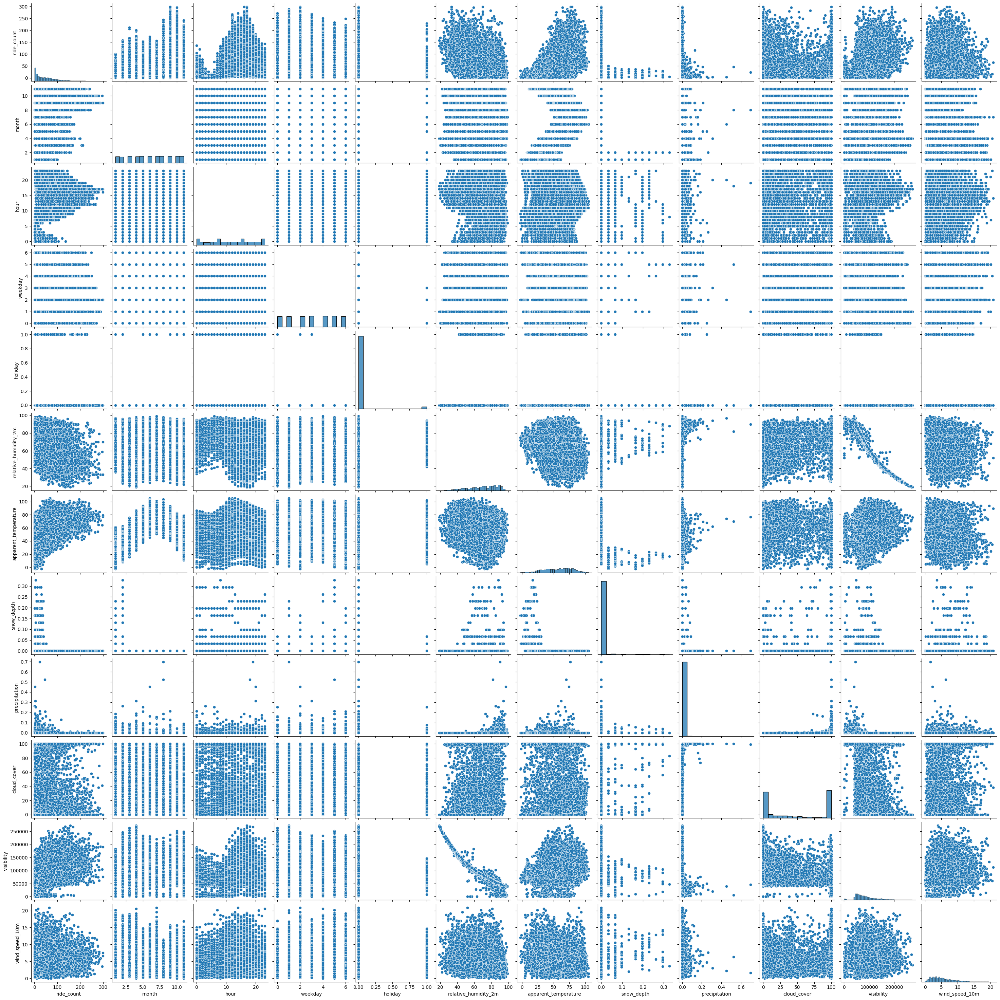

In [ ]:
dimensions = ['ride_count','month', 'hour','weekday','holiday','relative_humidity_2m',
                                                      'apparent_temperature', 'snow_depth',
                                                     'precipitation','cloud_cover', 'visibility', 'wind_speed_10m'
                                                     ]
#a pairplot shows every variable plotted against one another in a scatter plot, revealing visual patterns that help us understand
#potential relationships between the variables
sns.pairplot(hourly_weather[dimensions])

In [ ]:
var_dict = {}
for x in dimensions[1:]:
    corr_coef = np.corrcoef(hourly_weather[x], hourly_weather.ride_count)[0, 1]
    var_dict[x] = corr_coef

We can also understand these variable relationships using correlation coefficients - these are values between 1 and -1, representing the relationship's strength. The farther from zero the coefficient is, the stronger the correlation with hourly POGOH ridership. You can see below that some of our strongest relationships to ride count are visibility, apparent temperature, hour, wind speed, and relative humidity.

In [ ]:
sorted_by_values = dict(sorted(var_dict.items(), key=lambda item: item[1], reverse=True))
sorted_by_values

{'visibility': 0.4824827125695732,
 'apparent_temperature': 0.39769073395457466,
 'hour': 0.39631460575423955,
 'month': 0.3494277240213525,
 'wind_speed_10m': 0.1515868172902298,
 'holiday': -0.03549265359920659,
 'weekday': -0.05439474162752816,
 'precipitation': -0.0772811659066286,
 'snow_depth': -0.09814477258882737,
 'cloud_cover': -0.13565427226406937,
 'relative_humidity_2m': -0.4925019088049568}

## Preliminary Recommendations & Next Steps
Our initial exploration into POGOH's 2023-2024 data revealed some useful insights. There are several ways these insights could be used to help decision makers at POGOH better serve their consumers. A few examples:

- Knowing students are likely a large population of riders, offer student-specific memberships that cater to their needs and may encourage more students to join (i.e. only active Aug-May)
- Identify popular events where parking will be limited, and offer additional bikes/docks on those days near the event. Allow event locations to sponsor additional bikes to reduce congestion/stress near their event.
- As members (who probably have the app) represent the majority of rides, solicit user feedback through the app to improve the member experience - update the POGOH rider app accordingly.
- I'd also like to be able to predict ridership in order to help planning of maintenance times, bike count needs at each station, and potential ride surges... (see below!)
---
Now that we're beginning to understand the shape of this data and how each variable relates to my target (ride count), I'm prepping to iterate on some predictive models using Scikit-Learn. Some next steps on this project will be:
- removing colinear features & prepping the data to be modelled
- deciding on the granularity of my target according to the most intriguing business questions (predict overall hourly ridership? station-wise hourly ridership?)
- building my chosen model and engineering it to improve its predictive capabilities

Thanks for following along!